In [1]:
import os
import cv2
import numpy as np
from tqdm import tqdm
import tensorflow as tf
from matplotlib import pyplot as plt
from tensorflow.keras.models import Model
from skimage.metrics import mean_squared_error
from skimage.metrics import peak_signal_noise_ratio
from skimage.metrics import structural_similarity as ssim
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, LeakyReLU, Concatenate, ReLU, \
    BatchNormalization, Dropout

2024-03-29 11:00:13.075269: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-29 11:00:13.075369: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-29 11:00:13.209664: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
batch_size = 64
img_size = 128

root_dir = '/kaggle/input/image-colorization-dataset/data/'
train_black_dir = root_dir + 'train_black/'
train_color_dir = root_dir + 'train_color/'
test_black_dir = root_dir + 'test_black/'
test_color_dir = root_dir + 'test_color/'

In [3]:
def process_image(img_dir, channels):
    if channels == 3:
        img = cv2.imread(img_dir, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    else:
        img = cv2.imread(img_dir, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (img_size, img_size))
    img = cv2.normalize(img, None, 0., 1., norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    return img


def prepare_images(img_dir, channels):
    print("Preparing images from :  ", img_dir)
    img_dirs = [os.path.join(img_dir, filename) for filename in os.listdir(img_dir)]
    img_dirs.sort()
    processed_images = [process_image(img_dir, channels) for img_dir in tqdm(img_dirs)]
    return processed_images


train_black = prepare_images(train_black_dir, channels=1)
train_color = prepare_images(train_color_dir, channels=3)
test_black = prepare_images(test_black_dir, channels=1)
test_color = prepare_images(test_color_dir, channels=3)

Preparing images from :   /kaggle/input/image-colorization-dataset/data/train_black/


100%|██████████| 5000/5000 [01:00<00:00, 82.87it/s]


Preparing images from :   /kaggle/input/image-colorization-dataset/data/train_color/


100%|██████████| 5000/5000 [01:22<00:00, 60.71it/s]


Preparing images from :   /kaggle/input/image-colorization-dataset/data/test_black/


100%|██████████| 739/739 [00:07<00:00, 101.49it/s]


Preparing images from :   /kaggle/input/image-colorization-dataset/data/test_color/


100%|██████████| 739/739 [00:10<00:00, 67.76it/s]


In [4]:
def create_dataset(X, y, cache, shuffle=False, repeat=False):
    dataset = tf.data.Dataset.from_tensor_slices((X, y))
    dataset = dataset.cache(cache)
    if shuffle:
        dataset = dataset.shuffle(buffer_size=dataset.cardinality(), reshuffle_each_iteration=True)
    if repeat:
        dataset = dataset.repeat()
    dataset = dataset.batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset


train_dataset = create_dataset(train_black, train_color, cache='trainset', shuffle=True)
test_dataset = create_dataset(test_black, test_color, cache='testset', shuffle=False)

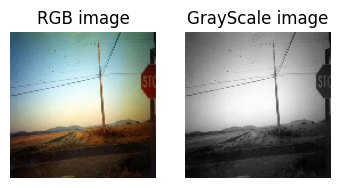

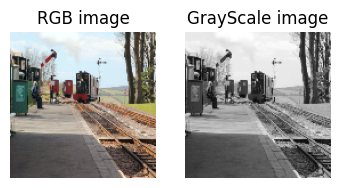

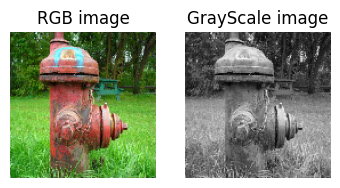

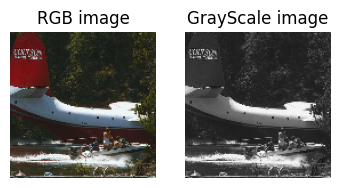

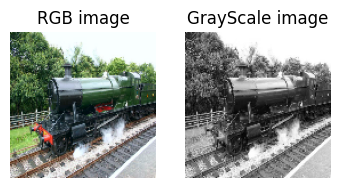

In [5]:
def plot_history(history, metric):
    plt.plot(history[metric])
    name = metric.replace('_', ' ')
    plt.title('Model ' + name.title())
    plt.ylabel(name.upper())
    plt.xlabel('epoch')
    plt.show()


def plot_images(img1, img2, img3=None):
    def plot_each(img, i):
        plt.subplot(1, 3, i)
        plt.imshow(img, cmap=plt.cm.gray)
        plt.title('RGB image' if i == 1 else ('GrayScale image' if i == 2 else 'Generated image'))
        plt.axis('off')

    img1 = cv2.normalize(img1.numpy(), None, 0., 255., norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    img1 = cv2.cvtColor(img1, cv2.COLOR_LAB2RGB)
    plot_each(img1, 1)
    plot_each(img2, 2)
    if img3 is not None:
        img3 = cv2.normalize(img3.numpy(), None, 0., 255., norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
        img3 = cv2.cvtColor(img3, cv2.COLOR_LAB2RGB)
        plot_each(img3, 3)
    plt.show()


sampled_data = test_dataset.take(5)
for i, (X, y) in enumerate(sampled_data):
    plot_images(y[i], X[i])

In [6]:
class UNetAutoencoder():

    def __encoder(self, input_shape):
        inputs = Input(input_shape)

        # Encoder
        conv1 = Conv2D(64, 3, padding='same')(inputs)
        conv1 = LeakyReLU()(conv1)

        conv1 = Conv2D(64, 3, padding='same')(conv1)
        conv1 = LeakyReLU()(conv1)

        pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

        conv2 = Conv2D(128, 3, padding='same')(pool1)
        conv2 = BatchNormalization()(conv2)
        conv2 = LeakyReLU()(conv2)

        conv2 = Conv2D(128, 3, padding='same')(conv2)
        conv2 = BatchNormalization()(conv2)
        conv2 = LeakyReLU()(conv2)

        pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

        conv3 = Conv2D(256, 3, padding='same')(pool2)
        conv3 = BatchNormalization()(conv3)
        conv3 = LeakyReLU()(conv3)

        conv3 = Conv2D(256, 3, padding='same')(conv3)
        conv3 = BatchNormalization()(conv3)
        conv3 = LeakyReLU()(conv3)

        pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

        conv4 = Conv2D(512, 3, padding='same')(pool3)
        conv4 = BatchNormalization()(conv4)
        conv4 = LeakyReLU()(conv4)

        conv4 = Conv2D(512, 3, padding='same')(conv4)
        conv4 = BatchNormalization()(conv4)
        conv4 = LeakyReLU()(conv4)

        pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

        # Bottleneck
        conv5 = Conv2D(1024, 3, padding='same')(pool4)
        conv5 = BatchNormalization()(conv5)
        conv5 = LeakyReLU()(conv5)

        return [inputs, conv1, conv2, conv3, conv4, conv5]

    def __decoder(self, encoder_layers):
        inputs, conv1, conv2, conv3, conv4, latenant_space = encoder_layers

        # Decoder
        up6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(latenant_space)
        up6 = BatchNormalization()(up6)
        up6 = Dropout(0.3)(up6)
        up6 = Concatenate()([up6, conv4])

        conv6 = Conv2D(512, 3, padding='same')(up6)
        conv6 = BatchNormalization()(conv6)
        conv6 = Dropout(0.3)(conv6)
        conv6 = ReLU()(conv6)

        conv6 = Conv2D(512, 3, padding='same')(conv6)
        conv6 = BatchNormalization()(conv6)
        conv6 = ReLU()(conv6)

        up7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv6)
        up7 = BatchNormalization()(up7)
        up7 = Concatenate()([up7, conv3])

        conv7 = Conv2D(256, 3, padding='same')(up7)
        conv7 = BatchNormalization()(conv7)
        conv7 = ReLU()(conv7)

        conv7 = Conv2D(256, 3, padding='same')(conv7)
        conv7 = BatchNormalization()(conv7)
        conv7 = ReLU()(conv7)

        up8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv7)
        up8 = BatchNormalization()(up8)
        up8 = Concatenate()([up8, conv2])

        conv8 = Conv2D(128, 3, padding='same')(up8)
        conv8 = BatchNormalization()(conv8)
        conv8 = ReLU()(conv8)

        conv8 = Conv2D(128, 3, padding='same')(conv8)
        conv8 = BatchNormalization()(conv8)
        conv8 = ReLU()(conv8)

        up9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv8)
        up9 = BatchNormalization()(up9)
        up9 = Concatenate()([up9, conv1])

        conv9 = Conv2D(64, 3, padding='same')(up9)
        conv9 = BatchNormalization()(conv9)
        conv9 = ReLU()(conv9)

        conv9 = Conv2D(64, 3, padding='same')(conv9)
        conv9 = BatchNormalization()(conv9)
        conv9 = ReLU()(conv9)

        outputs = Conv2D(3, 1, activation='tanh')(conv9)

        return outputs

    def create_model(self, input_shape):
        encoder_layers = self.__encoder(input_shape)
        decoder_output = self.__decoder(encoder_layers)
        return Model(inputs=encoder_layers[0], outputs=decoder_output, name='UNetAutoencoder')


generator_1 = UNetAutoencoder().create_model(input_shape=(img_size, img_size, 1))
generator_1.summary()

Model: "UNetAutoencoder"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 128, 128,  │          0 │ conv2d[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │     36,928 │ leaky_re_lu[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 128, 128,  │          0 │ conv2d_1[0][0]    │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 64, 64,    │          0 │ leaky_re_lu_1[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 64, 64,    │        512 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │    147,584 │ leaky_re_lu_2[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 32, 32,    │          0 │ leaky_re_lu_3[0]… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 32, 32,    │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_4       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 32, 32,    │    590,080 │ leaky_re_lu_4[0]

 Total params: 21,615,299 (82.46 MB)

 Trainable params: 21,603,907 (82.41 MB)

 Non-trainable params: 11,392 (44.50 KB)

In [7]:
class PatchGAN():
    def __downsample_block(self, x, filters, kernel_size=4, strides=2, apply_batchnorm=True):
        initializer = tf.random_normal_initializer(0., 0.02)

        conv = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding='same',
                      kernel_initializer=initializer)(x)

        if apply_batchnorm:
            conv = BatchNormalization()(conv)

        return LeakyReLU()(conv)

    def __PatchGAN(self, input_shape, num_filters):
        self.inputs = Input(shape=input_shape)
        down1 = self.__downsample_block(self.inputs, num_filters, apply_batchnorm=False)
        down2 = self.__downsample_block(down1, num_filters * 2)
        return self.__downsample_block(down2, num_filters * 4)

    def create_model(self, input_shape, num_filters):
        base_model = self.__PatchGAN(input_shape, num_filters)
        patch_output = Conv2D(1, kernel_size=4, strides=1, padding='same', activation='sigmoid')(base_model)
        return Model(inputs=self.inputs, outputs=patch_output, name='PatchGAN-Discriminator')


discriminator = PatchGAN().create_model(input_shape=(img_size, img_size, 3), num_filters=64)
discriminator.summary()

Model: "PatchGAN-Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 64, 64, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 32, 32, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_10 (LeakyReLU)      │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_20 (Conv2D)              │ (None, 16, 16, 256)    │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_11 (LeakyReLU)      │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 16, 16, 1)      │         4,097 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 664,513 (2.53 MB)

 Trainable params: 663,745 (2.53 MB)

 Non-trainable params: 768 (3.00 KB)

In [8]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)


def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) - tf.random.uniform(shape=real_output.shape, maxval=0.1),
                              real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output) + tf.random.uniform(shape=fake_output.shape, maxval=0.1),
                              fake_output)
    return real_loss + fake_loss


def generator_loss(real_output, fake_output):
    return mse(real_output, fake_output)

In [9]:
@tf.function
def train_step(gray_images, rgb_images):
    with tf.GradientTape() as generator_tape, tf.GradientTape() as discriminator_tape:
        fake_rgb_images = generator_1(gray_images, training=True)
        real_output = discriminator(rgb_images, training=True)
        fake_output = discriminator(fake_rgb_images, training=True)
        reconstruction_loss = generator_loss(rgb_images, fake_rgb_images)
        total_discriminator_loss = discriminator_loss(real_output, fake_output)
    gradients_of_generator = generator_tape.gradient(reconstruction_loss, generator_1.trainable_variables)
    gradients_of_discriminator = discriminator_tape.gradient(total_discriminator_loss,
                                                             discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_1.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return reconstruction_loss, total_discriminator_loss

In [10]:
def fit(train_dataset, epochs):
    history = {}
    g_losses, d_losses = [], []
    print("{:d} Epochs | {:d} iterations per epoch".format(epochs,
                                                           tf.data.experimental.cardinality(train_dataset).numpy()))
    for epoch in range(epochs):
        epoch_g_loss_avg = tf.keras.metrics.Mean()
        epoch_d_loss_avg = tf.keras.metrics.Mean()
        for step, (batch_gray_images, batch_rgb_images) in tqdm(enumerate(train_dataset)):
            g_loss, d_loss = train_step(batch_gray_images, batch_rgb_images)
            epoch_g_loss_avg.update_state(g_loss)
            epoch_d_loss_avg.update_state(d_loss)
        g_losses.append(epoch_g_loss_avg.result())
        d_losses.append(epoch_d_loss_avg.result())
        print("Epoch {:d}/{:d}: Generator Loss: {:.5f}, Discriminator Loss: {:.5f}".format(epoch + 1, epochs,
                                                                                           epoch_g_loss_avg.result(),
                                                                                           epoch_d_loss_avg.result()))
    history['generator_loss'] = g_losses
    history['discriminator_loss'] = d_losses
    return history

In [11]:
history_1 = fit(train_dataset, epochs=100)

100 Epochs | 79 iterations per epoch


0it [00:00, ?it/s]2024-03-29 11:07:00.324754: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inUNetAutoencoder_1/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
78it [01:29,  1.62it/s]2024-03-29 11:08:19.896064: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inUNetAutoencoder_1/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
79it [01:39,  1.26s/it]


Epoch 1/100: Generator Loss: 0.05386, Discriminator Loss: 0.60049


79it [00:49,  1.59it/s]


Epoch 2/100: Generator Loss: 0.00699, Discriminator Loss: 0.40494


79it [00:49,  1.59it/s]


Epoch 3/100: Generator Loss: 0.00767, Discriminator Loss: 0.40147


79it [00:49,  1.59it/s]


Epoch 4/100: Generator Loss: 0.00567, Discriminator Loss: 0.40293


79it [00:49,  1.59it/s]


Epoch 5/100: Generator Loss: 0.00468, Discriminator Loss: 0.41172


79it [00:49,  1.59it/s]


Epoch 6/100: Generator Loss: 0.00407, Discriminator Loss: 0.49470


79it [00:49,  1.59it/s]


Epoch 7/100: Generator Loss: 0.00377, Discriminator Loss: 0.93329


79it [00:49,  1.59it/s]


Epoch 8/100: Generator Loss: 0.00376, Discriminator Loss: 0.46625


79it [00:49,  1.59it/s]


Epoch 9/100: Generator Loss: 0.00366, Discriminator Loss: 0.43369


79it [00:49,  1.61it/s]


Epoch 10/100: Generator Loss: 0.00375, Discriminator Loss: 0.41343


79it [00:49,  1.59it/s]


Epoch 11/100: Generator Loss: 0.00641, Discriminator Loss: 0.44141


79it [00:49,  1.59it/s]


Epoch 12/100: Generator Loss: 0.00423, Discriminator Loss: 0.42141


79it [00:49,  1.60it/s]


Epoch 13/100: Generator Loss: 0.00380, Discriminator Loss: 0.42285


79it [00:49,  1.60it/s]


Epoch 14/100: Generator Loss: 0.00352, Discriminator Loss: 0.40977


79it [00:49,  1.60it/s]


Epoch 15/100: Generator Loss: 0.00341, Discriminator Loss: 0.40849


79it [00:49,  1.59it/s]


Epoch 16/100: Generator Loss: 0.00339, Discriminator Loss: 0.40724


79it [00:49,  1.60it/s]


Epoch 17/100: Generator Loss: 0.00356, Discriminator Loss: 0.41034


79it [00:49,  1.59it/s]


Epoch 18/100: Generator Loss: 0.00341, Discriminator Loss: 0.40708


79it [00:49,  1.59it/s]


Epoch 19/100: Generator Loss: 0.00328, Discriminator Loss: 0.40589


79it [00:49,  1.60it/s]


Epoch 20/100: Generator Loss: 0.00334, Discriminator Loss: 0.40471


79it [00:49,  1.60it/s]


Epoch 21/100: Generator Loss: 0.00336, Discriminator Loss: 0.40570


79it [00:49,  1.59it/s]


Epoch 22/100: Generator Loss: 0.00329, Discriminator Loss: 0.40324


79it [00:49,  1.59it/s]


Epoch 23/100: Generator Loss: 0.00333, Discriminator Loss: 0.41473


79it [00:48,  1.61it/s]


Epoch 24/100: Generator Loss: 0.00325, Discriminator Loss: 0.43177


79it [00:49,  1.61it/s]


Epoch 25/100: Generator Loss: 0.00321, Discriminator Loss: 0.40915


79it [00:49,  1.59it/s]


Epoch 26/100: Generator Loss: 0.00326, Discriminator Loss: 0.40683


79it [00:49,  1.59it/s]


Epoch 27/100: Generator Loss: 0.00315, Discriminator Loss: 0.40598


79it [00:49,  1.60it/s]


Epoch 28/100: Generator Loss: 0.00315, Discriminator Loss: 0.40758


79it [00:49,  1.60it/s]


Epoch 29/100: Generator Loss: 0.00324, Discriminator Loss: 0.40634


79it [00:49,  1.60it/s]


Epoch 30/100: Generator Loss: 0.00320, Discriminator Loss: 0.40254


79it [00:49,  1.59it/s]


Epoch 31/100: Generator Loss: 0.00314, Discriminator Loss: 0.40984


79it [00:49,  1.60it/s]


Epoch 32/100: Generator Loss: 0.00321, Discriminator Loss: 0.41159


79it [00:49,  1.59it/s]


Epoch 33/100: Generator Loss: 0.00320, Discriminator Loss: 0.40917


79it [00:49,  1.61it/s]


Epoch 34/100: Generator Loss: 0.00317, Discriminator Loss: 0.40834


79it [00:49,  1.59it/s]


Epoch 35/100: Generator Loss: 0.00309, Discriminator Loss: 0.40953


79it [00:49,  1.59it/s]


Epoch 36/100: Generator Loss: 0.00308, Discriminator Loss: 0.41177


79it [00:49,  1.59it/s]


Epoch 37/100: Generator Loss: 0.00316, Discriminator Loss: 0.40439


79it [00:49,  1.59it/s]


Epoch 38/100: Generator Loss: 0.00326, Discriminator Loss: 0.44912


79it [00:49,  1.61it/s]


Epoch 39/100: Generator Loss: 0.00311, Discriminator Loss: 0.41775


79it [00:49,  1.59it/s]


Epoch 40/100: Generator Loss: 0.00312, Discriminator Loss: 0.41310


79it [00:49,  1.59it/s]


Epoch 41/100: Generator Loss: 0.00302, Discriminator Loss: 0.41010


79it [00:49,  1.59it/s]


Epoch 42/100: Generator Loss: 0.00303, Discriminator Loss: 0.41450


79it [00:49,  1.59it/s]


Epoch 43/100: Generator Loss: 0.00303, Discriminator Loss: 0.40486


79it [00:49,  1.59it/s]


Epoch 44/100: Generator Loss: 0.00300, Discriminator Loss: 0.40373


79it [00:49,  1.59it/s]


Epoch 45/100: Generator Loss: 0.00295, Discriminator Loss: 0.40927


79it [00:49,  1.59it/s]


Epoch 46/100: Generator Loss: 0.00296, Discriminator Loss: 0.40799


79it [00:49,  1.59it/s]


Epoch 47/100: Generator Loss: 0.00300, Discriminator Loss: 0.41638


79it [00:49,  1.60it/s]


Epoch 48/100: Generator Loss: 0.00301, Discriminator Loss: 0.41324


79it [00:49,  1.59it/s]


Epoch 49/100: Generator Loss: 0.00296, Discriminator Loss: 0.40570


79it [00:49,  1.59it/s]


Epoch 50/100: Generator Loss: 0.00299, Discriminator Loss: 0.40909


79it [00:49,  1.59it/s]


Epoch 51/100: Generator Loss: 0.00297, Discriminator Loss: 0.40657


79it [00:49,  1.59it/s]


Epoch 52/100: Generator Loss: 0.00295, Discriminator Loss: 0.41040


79it [00:49,  1.60it/s]


Epoch 53/100: Generator Loss: 0.00296, Discriminator Loss: 0.41339


79it [00:49,  1.59it/s]


Epoch 54/100: Generator Loss: 0.00302, Discriminator Loss: 0.40676


79it [00:49,  1.59it/s]


Epoch 55/100: Generator Loss: 0.00299, Discriminator Loss: 0.41176


79it [00:49,  1.60it/s]


Epoch 56/100: Generator Loss: 0.00296, Discriminator Loss: 0.40936


79it [00:49,  1.59it/s]


Epoch 57/100: Generator Loss: 0.00292, Discriminator Loss: 0.40720


79it [00:49,  1.60it/s]


Epoch 58/100: Generator Loss: 0.00299, Discriminator Loss: 0.40483


79it [00:49,  1.59it/s]


Epoch 59/100: Generator Loss: 0.00291, Discriminator Loss: 0.40791


79it [00:49,  1.59it/s]


Epoch 60/100: Generator Loss: 0.00291, Discriminator Loss: 0.41546


79it [00:49,  1.59it/s]


Epoch 61/100: Generator Loss: 0.00293, Discriminator Loss: 0.41135


79it [00:49,  1.59it/s]


Epoch 62/100: Generator Loss: 0.00294, Discriminator Loss: 0.41161


79it [00:49,  1.59it/s]


Epoch 63/100: Generator Loss: 0.00289, Discriminator Loss: 0.40539


79it [00:49,  1.60it/s]


Epoch 64/100: Generator Loss: 0.00294, Discriminator Loss: 0.40817


79it [00:49,  1.59it/s]


Epoch 65/100: Generator Loss: 0.00287, Discriminator Loss: 0.40477


79it [00:49,  1.59it/s]


Epoch 66/100: Generator Loss: 0.00283, Discriminator Loss: 0.40950


79it [00:49,  1.59it/s]


Epoch 67/100: Generator Loss: 0.00288, Discriminator Loss: 0.41135


79it [00:49,  1.59it/s]


Epoch 68/100: Generator Loss: 0.00289, Discriminator Loss: 0.40676


79it [00:49,  1.59it/s]


Epoch 69/100: Generator Loss: 0.00286, Discriminator Loss: 0.40751


79it [00:49,  1.59it/s]


Epoch 70/100: Generator Loss: 0.00283, Discriminator Loss: 0.41647


79it [00:49,  1.59it/s]


Epoch 71/100: Generator Loss: 0.00288, Discriminator Loss: 0.43167


79it [00:49,  1.59it/s]


Epoch 72/100: Generator Loss: 0.00287, Discriminator Loss: 0.41125


79it [00:49,  1.59it/s]


Epoch 73/100: Generator Loss: 0.00286, Discriminator Loss: 0.40809


79it [00:49,  1.59it/s]


Epoch 74/100: Generator Loss: 0.00282, Discriminator Loss: 0.41364


79it [00:49,  1.59it/s]


Epoch 75/100: Generator Loss: 0.00281, Discriminator Loss: 0.42137


79it [00:49,  1.59it/s]


Epoch 76/100: Generator Loss: 0.00279, Discriminator Loss: 0.40891


79it [00:49,  1.59it/s]


Epoch 77/100: Generator Loss: 0.00281, Discriminator Loss: 0.41223


79it [00:49,  1.59it/s]


Epoch 78/100: Generator Loss: 0.00280, Discriminator Loss: 0.41170


79it [00:49,  1.59it/s]


Epoch 79/100: Generator Loss: 0.00286, Discriminator Loss: 0.41380


79it [00:49,  1.60it/s]


Epoch 80/100: Generator Loss: 0.00277, Discriminator Loss: 0.41469


79it [00:49,  1.59it/s]


Epoch 81/100: Generator Loss: 0.00279, Discriminator Loss: 0.40819


79it [00:49,  1.59it/s]


Epoch 82/100: Generator Loss: 0.00277, Discriminator Loss: 0.41319


79it [00:49,  1.59it/s]


Epoch 83/100: Generator Loss: 0.00273, Discriminator Loss: 0.40691


79it [00:49,  1.59it/s]


Epoch 84/100: Generator Loss: 0.00274, Discriminator Loss: 0.41953


79it [00:49,  1.59it/s]


Epoch 85/100: Generator Loss: 0.00278, Discriminator Loss: 0.42835


79it [00:49,  1.59it/s]


Epoch 86/100: Generator Loss: 0.00271, Discriminator Loss: 0.41832


79it [00:49,  1.59it/s]


Epoch 87/100: Generator Loss: 0.00271, Discriminator Loss: 0.42156


79it [00:49,  1.60it/s]


Epoch 88/100: Generator Loss: 0.00267, Discriminator Loss: 0.41591


79it [00:49,  1.59it/s]


Epoch 89/100: Generator Loss: 0.00265, Discriminator Loss: 0.41128


79it [00:49,  1.59it/s]


Epoch 90/100: Generator Loss: 0.00261, Discriminator Loss: 0.42505


79it [00:49,  1.59it/s]


Epoch 91/100: Generator Loss: 0.00260, Discriminator Loss: 0.42454


79it [00:49,  1.59it/s]


Epoch 92/100: Generator Loss: 0.00254, Discriminator Loss: 0.42586


79it [00:49,  1.59it/s]


Epoch 93/100: Generator Loss: 0.00253, Discriminator Loss: 0.42489


79it [00:49,  1.59it/s]


Epoch 94/100: Generator Loss: 0.00256, Discriminator Loss: 0.42839


79it [00:49,  1.60it/s]


Epoch 95/100: Generator Loss: 0.00247, Discriminator Loss: 0.44421


79it [00:49,  1.60it/s]


Epoch 96/100: Generator Loss: 0.00248, Discriminator Loss: 0.44933


79it [00:49,  1.59it/s]


Epoch 97/100: Generator Loss: 0.00243, Discriminator Loss: 0.42613


79it [00:49,  1.59it/s]


Epoch 98/100: Generator Loss: 0.00242, Discriminator Loss: 0.41940


79it [00:49,  1.60it/s]


Epoch 99/100: Generator Loss: 0.00239, Discriminator Loss: 0.42337


79it [00:49,  1.59it/s]


Epoch 100/100: Generator Loss: 0.00236, Discriminator Loss: 0.41374


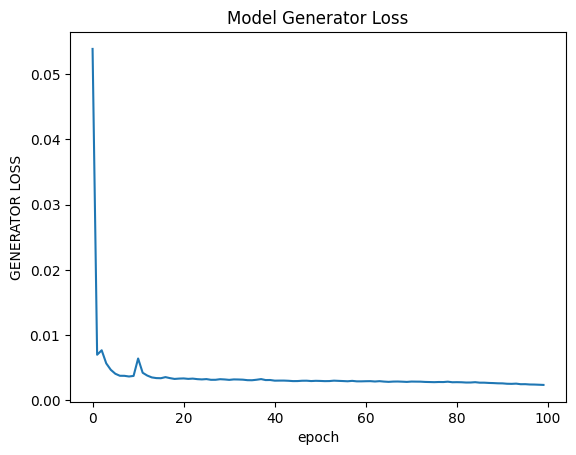

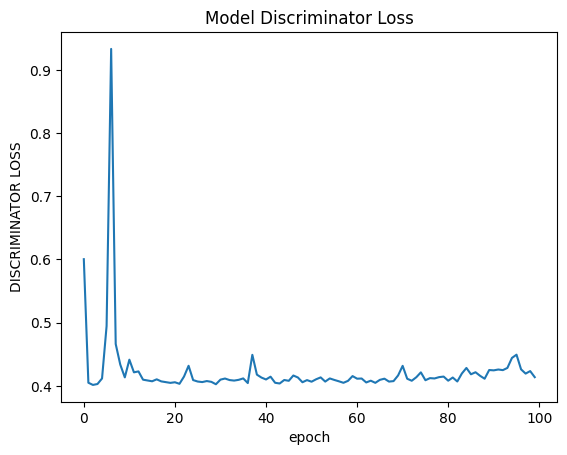

In [12]:
plot_history(history_1, 'generator_loss', )
plot_history(history_1, 'discriminator_loss')

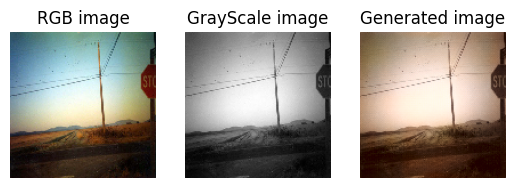

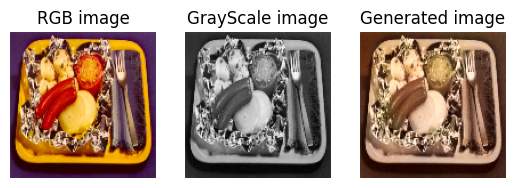

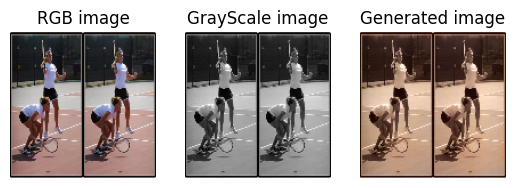

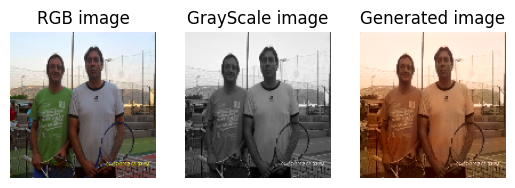

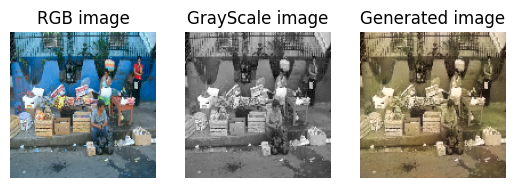

...

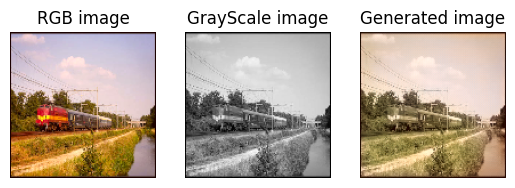

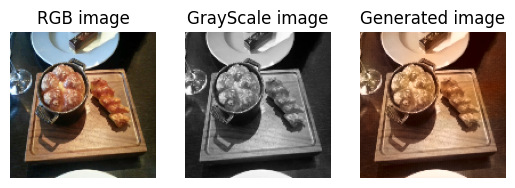

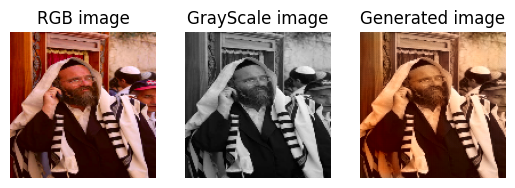

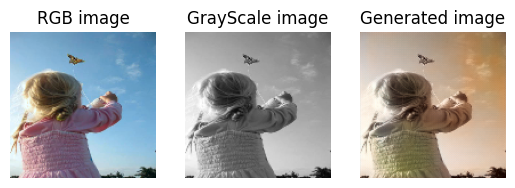

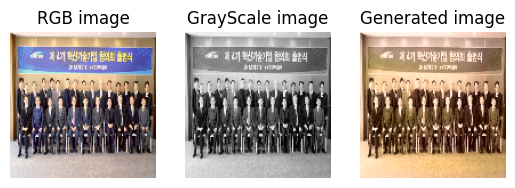

In [13]:
sample_X, sample_Y = next(iter(test_dataset))
generated_rgb_1 = generator_1(sample_X, training=False)

for i in range(len(sample_X)):
    plot_images(sample_Y[i], sample_X[i], generated_rgb_1[i])

# Improvments: Customized Loss Functions

In [14]:
generator_2 = UNetAutoencoder().create_model(input_shape=(img_size, img_size, 1))
discriminator = PatchGAN().create_model(input_shape=(img_size, img_size, 3), num_filters=64)

In [15]:
LAMBDA = 100

cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)


def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss


def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = cross_entropy(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = mse(tf.cast(target, tf.float64), tf.cast(gen_output, tf.float64))
    return gan_loss + (LAMBDA * l1_loss)

In [16]:
@tf.function
def train_step(gray_images, rgb_images):
    with tf.GradientTape() as generator_tape, tf.GradientTape() as discriminator_tape:
        fake_rgb_images = generator_2(gray_images, training=True)
        real_output = discriminator(rgb_images, training=True)
        fake_output = discriminator(fake_rgb_images, training=True)
        reconstruction_loss = generator_loss(real_output, fake_rgb_images, rgb_images)
        total_discriminator_loss = discriminator_loss(real_output, fake_output)
    gradients_of_generator = generator_tape.gradient(reconstruction_loss, generator_2.trainable_variables)
    gradients_of_discriminator = discriminator_tape.gradient(total_discriminator_loss,
                                                             discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_2.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return reconstruction_loss, total_discriminator_loss

In [17]:
history_2 = fit(train_dataset, epochs=100)

100 Epochs | 79 iterations per epoch


0it [00:00, ?it/s]2024-03-29 13:01:08.395481: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inUNetAutoencoder_1/dropout_2_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
79it [01:10,  1.12it/s]


Epoch 1/100: Generator Loss: 3.73479, Discriminator Loss: 0.36528


79it [00:49,  1.59it/s]


Epoch 2/100: Generator Loss: 0.89972, Discriminator Loss: 0.03921


79it [00:49,  1.61it/s]


Epoch 3/100: Generator Loss: 0.92357, Discriminator Loss: 0.00501


79it [00:49,  1.59it/s]


Epoch 4/100: Generator Loss: 0.45538, Discriminator Loss: 0.00288


79it [00:49,  1.59it/s]


Epoch 5/100: Generator Loss: 1.20546, Discriminator Loss: 1.39173


79it [00:49,  1.60it/s]


Epoch 6/100: Generator Loss: 1.02583, Discriminator Loss: 1.27655


79it [00:49,  1.61it/s]


Epoch 7/100: Generator Loss: 0.56928, Discriminator Loss: 0.37659


79it [00:49,  1.61it/s]


Epoch 8/100: Generator Loss: 0.44411, Discriminator Loss: 0.14243


79it [00:48,  1.61it/s]


Epoch 9/100: Generator Loss: 0.36290, Discriminator Loss: 0.01401


79it [00:49,  1.61it/s]


Epoch 10/100: Generator Loss: 0.34922, Discriminator Loss: 0.01102


79it [00:49,  1.61it/s]


Epoch 11/100: Generator Loss: 0.34778, Discriminator Loss: 0.00778


79it [00:49,  1.59it/s]


Epoch 12/100: Generator Loss: 0.36243, Discriminator Loss: 0.00475


79it [00:49,  1.61it/s]


Epoch 13/100: Generator Loss: 0.34893, Discriminator Loss: 0.00419


79it [00:49,  1.59it/s]


Epoch 14/100: Generator Loss: 0.34740, Discriminator Loss: 0.00536


79it [00:48,  1.61it/s]


Epoch 15/100: Generator Loss: 0.34025, Discriminator Loss: 0.00238


79it [00:48,  1.61it/s]


Epoch 16/100: Generator Loss: 0.33388, Discriminator Loss: 0.00204


79it [00:49,  1.61it/s]


Epoch 17/100: Generator Loss: 0.32849, Discriminator Loss: 0.00177


79it [00:49,  1.61it/s]


Epoch 18/100: Generator Loss: 0.33493, Discriminator Loss: 0.01649


79it [00:49,  1.61it/s]


Epoch 19/100: Generator Loss: 0.45999, Discriminator Loss: 0.15100


79it [00:49,  1.59it/s]


Epoch 20/100: Generator Loss: 0.34910, Discriminator Loss: 0.01589


79it [00:49,  1.59it/s]


Epoch 21/100: Generator Loss: 0.33668, Discriminator Loss: 0.00971


79it [00:49,  1.60it/s]


Epoch 22/100: Generator Loss: 0.32841, Discriminator Loss: 0.00378


79it [00:49,  1.59it/s]


Epoch 23/100: Generator Loss: 0.32822, Discriminator Loss: 0.00308


79it [00:49,  1.61it/s]


Epoch 24/100: Generator Loss: 0.32312, Discriminator Loss: 0.00302


79it [00:49,  1.61it/s]


Epoch 25/100: Generator Loss: 0.31890, Discriminator Loss: 0.00239


79it [00:49,  1.61it/s]


Epoch 26/100: Generator Loss: 0.32334, Discriminator Loss: 0.00183


79it [00:49,  1.61it/s]


Epoch 27/100: Generator Loss: 0.31617, Discriminator Loss: 0.00150


79it [00:49,  1.59it/s]


Epoch 28/100: Generator Loss: 0.31347, Discriminator Loss: 0.00145


79it [00:49,  1.59it/s]


Epoch 29/100: Generator Loss: 0.31383, Discriminator Loss: 0.00156


79it [00:49,  1.60it/s]


Epoch 30/100: Generator Loss: 0.31622, Discriminator Loss: 0.00228


79it [00:48,  1.62it/s]


Epoch 31/100: Generator Loss: 0.31531, Discriminator Loss: 0.00189


79it [00:49,  1.59it/s]


Epoch 32/100: Generator Loss: 0.31487, Discriminator Loss: 0.00218


79it [00:49,  1.59it/s]


Epoch 33/100: Generator Loss: 0.31999, Discriminator Loss: 0.00268


79it [00:49,  1.60it/s]


Epoch 34/100: Generator Loss: 0.31211, Discriminator Loss: 0.00151


79it [00:49,  1.59it/s]


Epoch 35/100: Generator Loss: 0.30972, Discriminator Loss: 0.00104


79it [00:48,  1.61it/s]


Epoch 36/100: Generator Loss: 0.31251, Discriminator Loss: 0.00133


79it [00:49,  1.59it/s]


Epoch 37/100: Generator Loss: 0.30430, Discriminator Loss: 0.00087


79it [00:49,  1.59it/s]


Epoch 38/100: Generator Loss: 0.30181, Discriminator Loss: 0.00106


79it [00:49,  1.59it/s]


Epoch 39/100: Generator Loss: 0.31011, Discriminator Loss: 0.00098


79it [00:49,  1.59it/s]


Epoch 40/100: Generator Loss: 0.30799, Discriminator Loss: 0.00078


79it [00:49,  1.60it/s]


Epoch 41/100: Generator Loss: 0.30022, Discriminator Loss: 0.00077


79it [00:49,  1.60it/s]


Epoch 42/100: Generator Loss: 0.30275, Discriminator Loss: 0.00101


79it [00:49,  1.60it/s]


Epoch 43/100: Generator Loss: 0.29820, Discriminator Loss: 0.00111


79it [00:48,  1.61it/s]


Epoch 44/100: Generator Loss: 0.29738, Discriminator Loss: 0.00067


79it [00:49,  1.59it/s]


Epoch 45/100: Generator Loss: 0.29909, Discriminator Loss: 0.00111


79it [00:49,  1.60it/s]


Epoch 46/100: Generator Loss: 0.30138, Discriminator Loss: 0.00039


79it [00:48,  1.61it/s]


Epoch 47/100: Generator Loss: 0.29799, Discriminator Loss: 0.00023


79it [00:49,  1.60it/s]


Epoch 48/100: Generator Loss: 0.29836, Discriminator Loss: 0.00032


79it [00:49,  1.60it/s]


Epoch 49/100: Generator Loss: 0.29731, Discriminator Loss: 0.00037


79it [00:49,  1.60it/s]


Epoch 50/100: Generator Loss: 0.32854, Discriminator Loss: 0.08289


79it [00:49,  1.60it/s]


Epoch 51/100: Generator Loss: 0.30248, Discriminator Loss: 0.01311


79it [00:48,  1.61it/s]


Epoch 52/100: Generator Loss: 0.30140, Discriminator Loss: 0.00475


79it [00:49,  1.59it/s]


Epoch 53/100: Generator Loss: 0.30093, Discriminator Loss: 0.00597


79it [00:49,  1.59it/s]


Epoch 54/100: Generator Loss: 0.30607, Discriminator Loss: 0.01808


79it [00:48,  1.61it/s]


Epoch 55/100: Generator Loss: 0.30046, Discriminator Loss: 0.00170


79it [00:49,  1.60it/s]


Epoch 56/100: Generator Loss: 0.29203, Discriminator Loss: 0.00156


79it [00:49,  1.61it/s]


Epoch 57/100: Generator Loss: 0.29191, Discriminator Loss: 0.00109


79it [00:49,  1.60it/s]


Epoch 58/100: Generator Loss: 0.29561, Discriminator Loss: 0.00132


79it [00:49,  1.60it/s]


Epoch 59/100: Generator Loss: 0.28947, Discriminator Loss: 0.00108


79it [00:48,  1.61it/s]


Epoch 60/100: Generator Loss: 0.29844, Discriminator Loss: 0.00051


79it [00:49,  1.59it/s]


Epoch 61/100: Generator Loss: 0.30022, Discriminator Loss: 0.00069


79it [00:49,  1.59it/s]


Epoch 62/100: Generator Loss: 0.31595, Discriminator Loss: 0.02195


79it [00:49,  1.60it/s]


Epoch 63/100: Generator Loss: 0.34694, Discriminator Loss: 0.21816


79it [00:49,  1.60it/s]


Epoch 64/100: Generator Loss: 0.29268, Discriminator Loss: 0.00496


79it [00:49,  1.60it/s]


Epoch 65/100: Generator Loss: 0.28552, Discriminator Loss: 0.00204


79it [00:49,  1.60it/s]


Epoch 66/100: Generator Loss: 0.29674, Discriminator Loss: 0.01278


79it [00:49,  1.60it/s]


Epoch 67/100: Generator Loss: 0.29263, Discriminator Loss: 0.00197


79it [00:48,  1.61it/s]


Epoch 68/100: Generator Loss: 0.28928, Discriminator Loss: 0.00157


79it [00:49,  1.59it/s]


Epoch 69/100: Generator Loss: 0.28880, Discriminator Loss: 0.00197


79it [00:49,  1.59it/s]


Epoch 70/100: Generator Loss: 0.28689, Discriminator Loss: 0.00097


79it [00:49,  1.60it/s]


Epoch 71/100: Generator Loss: 0.28289, Discriminator Loss: 0.00100


79it [00:49,  1.60it/s]


Epoch 72/100: Generator Loss: 0.29076, Discriminator Loss: 0.00073


79it [00:49,  1.60it/s]


Epoch 73/100: Generator Loss: 0.28772, Discriminator Loss: 0.00074


79it [00:49,  1.60it/s]


Epoch 74/100: Generator Loss: 0.28248, Discriminator Loss: 0.00069


79it [00:49,  1.60it/s]


Epoch 75/100: Generator Loss: 0.28777, Discriminator Loss: 0.00532


79it [00:49,  1.60it/s]


Epoch 76/100: Generator Loss: 0.30486, Discriminator Loss: 0.03004


79it [00:49,  1.59it/s]


Epoch 77/100: Generator Loss: 0.28706, Discriminator Loss: 0.00139


79it [00:49,  1.59it/s]


Epoch 78/100: Generator Loss: 0.28865, Discriminator Loss: 0.00093


79it [00:49,  1.59it/s]


Epoch 79/100: Generator Loss: 0.28399, Discriminator Loss: 0.00100


79it [00:49,  1.60it/s]


Epoch 80/100: Generator Loss: 0.28071, Discriminator Loss: 0.00334


79it [00:49,  1.61it/s]


Epoch 81/100: Generator Loss: 0.28026, Discriminator Loss: 0.00359


79it [00:49,  1.60it/s]


Epoch 82/100: Generator Loss: 0.28088, Discriminator Loss: 0.00096


79it [00:49,  1.60it/s]


Epoch 83/100: Generator Loss: 0.27465, Discriminator Loss: 0.00069


79it [00:49,  1.59it/s]


Epoch 84/100: Generator Loss: 0.43520, Discriminator Loss: 0.15879


79it [00:49,  1.59it/s]


Epoch 85/100: Generator Loss: 0.29287, Discriminator Loss: 0.06566


79it [00:49,  1.60it/s]


Epoch 86/100: Generator Loss: 0.29159, Discriminator Loss: 0.02864


79it [00:49,  1.59it/s]


Epoch 87/100: Generator Loss: 0.27594, Discriminator Loss: 0.00346


79it [00:49,  1.59it/s]


Epoch 88/100: Generator Loss: 0.27805, Discriminator Loss: 0.00182


79it [00:49,  1.59it/s]


Epoch 89/100: Generator Loss: 0.28170, Discriminator Loss: 0.00635


79it [00:49,  1.59it/s]


Epoch 90/100: Generator Loss: 0.31092, Discriminator Loss: 0.02547


79it [00:49,  1.60it/s]


Epoch 91/100: Generator Loss: 0.29037, Discriminator Loss: 0.04908


79it [00:49,  1.59it/s]


Epoch 92/100: Generator Loss: 0.27402, Discriminator Loss: 0.00224


79it [00:49,  1.60it/s]


Epoch 93/100: Generator Loss: 0.28933, Discriminator Loss: 0.02884


79it [00:49,  1.59it/s]


Epoch 94/100: Generator Loss: 0.29482, Discriminator Loss: 0.04311


79it [00:49,  1.59it/s]


Epoch 95/100: Generator Loss: 0.28114, Discriminator Loss: 0.03335


79it [00:49,  1.59it/s]


Epoch 96/100: Generator Loss: 0.26878, Discriminator Loss: 0.00771


79it [00:49,  1.60it/s]


Epoch 97/100: Generator Loss: 0.26674, Discriminator Loss: 0.00299


79it [00:49,  1.59it/s]


Epoch 98/100: Generator Loss: 0.27281, Discriminator Loss: 0.01317


79it [00:48,  1.61it/s]


Epoch 99/100: Generator Loss: 0.28723, Discriminator Loss: 0.05068


79it [00:49,  1.59it/s]


Epoch 100/100: Generator Loss: 0.26770, Discriminator Loss: 0.00834


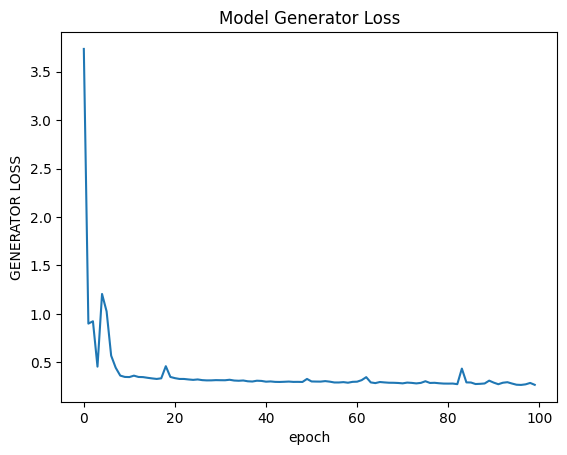

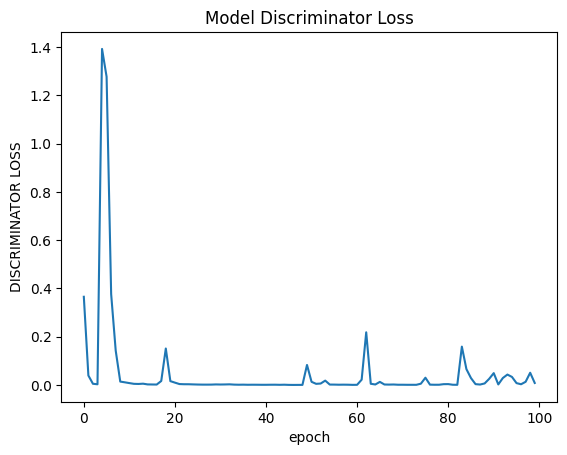

In [18]:
plot_history(history_2, 'generator_loss')
plot_history(history_2, 'discriminator_loss')

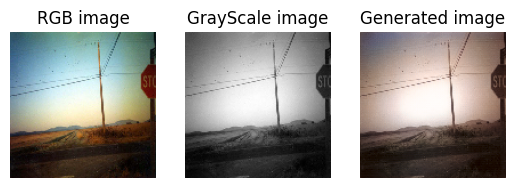

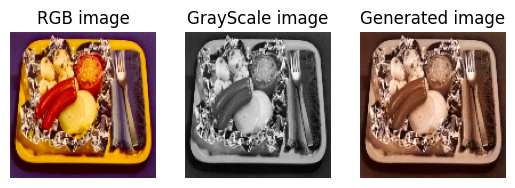

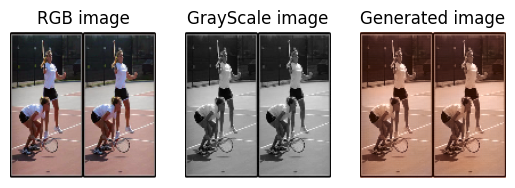

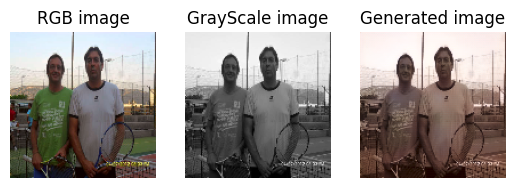

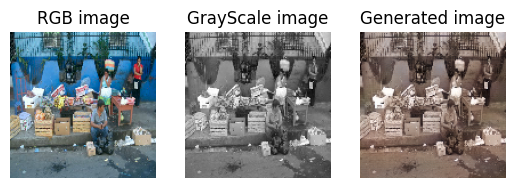

...

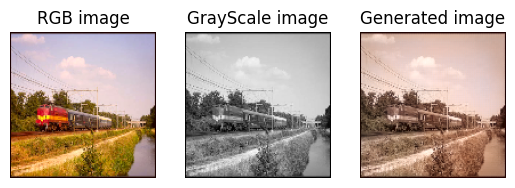

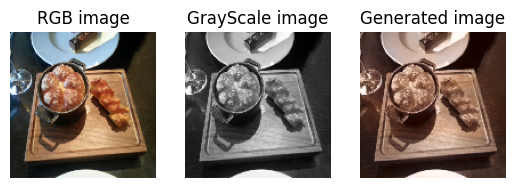

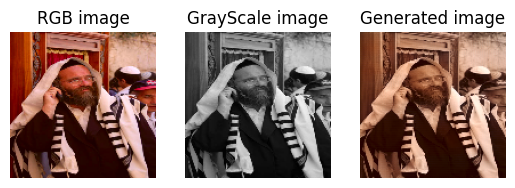

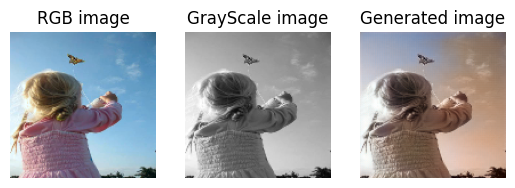

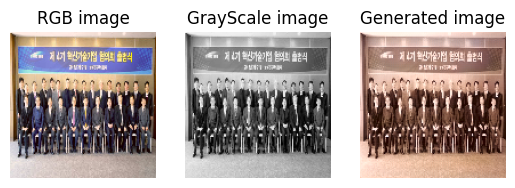

In [19]:
sample_X, sample_Y = next(iter(test_dataset))
generated_rgb_2 = generator_2(sample_X, training=False)

for i in range(len(sample_X)):
    plot_images(sample_Y[i], sample_X[i], generated_rgb_2[i])

# Evaluation Metrics

In [20]:
def calculate_colorfulness(image):
    (L, A, B) = cv2.split(image)
    (meanL, meanA, meanB) = (np.mean(L), np.mean(A), np.mean(B))
    (stdL, stdA, stdB) = (np.std(L), np.std(A), np.std(B))
    std = np.sqrt((stdL ** 2) + (stdA ** 2) + (stdB ** 2))
    mean = np.sqrt((meanL ** 2) + (meanA ** 2) + (meanB ** 2))
    return (std + (0.3 * mean)) * 100


def calculate_metrics(org_img, generated_rgb):
    mse_avg = []
    ssim_avg = []
    psnr_avg = []
    colorfulness_avg = []
    for index_ in range(len(org_img)):
        mse_score = mean_squared_error(org_img[index_].numpy(), generated_rgb[index_].numpy())
        ssim_score = ssim(org_img[index_].numpy(), generated_rgb[index_].numpy(), data_range=1., multichannel=True,
                          channel_axis=2)
        psnr_score = peak_signal_noise_ratio(org_img[index_].numpy(), generated_rgb[index_].numpy(), data_range=1.)
        colorfulness_score = calculate_colorfulness(generated_rgb[index_].numpy())
        mse_avg.append(mse_score)
        ssim_avg.append(ssim_score)
        psnr_avg.append(psnr_score)
        colorfulness_avg.append(colorfulness_score)
    return sum(mse_avg) / len(mse_avg), sum(ssim_avg) / len(ssim_avg), sum(psnr_avg) / len(psnr_avg), sum(
        colorfulness_avg) / len(colorfulness_avg)


mse_score1, ssim_score1, psnr_score1, colorfulness_score1 = calculate_metrics(sample_Y, generated_rgb_1)
print("Metrics for Generator 1")
print("MSE Score: ", mse_score1)
print("SSIM Score:", ssim_score1)
print("PSNR Score: ", psnr_score1)
print("Colorfulness Score: ", colorfulness_score1)

mse_score2, ssim_score2, psnr_score2, colorfulness_score2 = calculate_metrics(sample_Y, generated_rgb_2)
print("\nMetrics for Generator 2")
print("MSE Score: ", mse_score2)
print("SSIM Score:", ssim_score2)
print("PSNR Score: ", psnr_score2)
print("Colorfulness Score: ", colorfulness_score2)

Metrics for Generator 1
MSE Score:  0.0034124802506918343
SSIM Score: 0.8422593306750059
PSNR Score:  26.61101637522105
Colorfulness Score:  53.33079821682854

Metrics for Generator 2
MSE Score:  0.0034454065080940454
SSIM Score: 0.8500747596845031
PSNR Score:  26.97921466928513
Colorfulness Score:  51.967186249244214


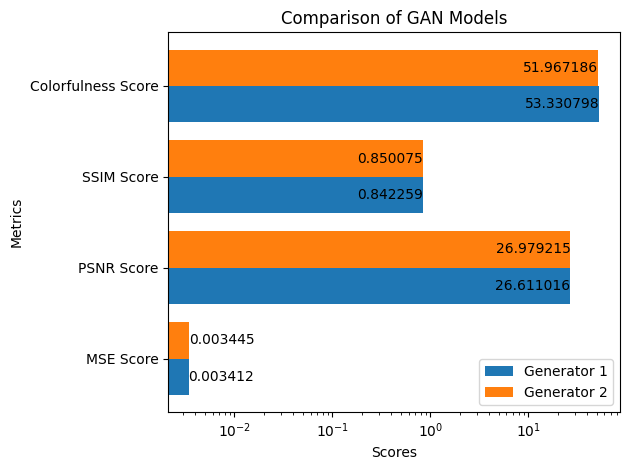

In [23]:
generator1_metrics = {
    "MSE Score": mse_score1,
    "PSNR Score": psnr_score1,
    "SSIM Score": ssim_score1,
    "Colorfulness Score": colorfulness_score1
}
generator2_metrics = {
    "MSE Score": mse_score2,
    "PSNR Score": psnr_score2,
    "SSIM Score": ssim_score2,
    "Colorfulness Score": colorfulness_score2
}
metrics = ["MSE Score", "PSNR Score", "SSIM Score", "Colorfulness Score"]
bar_width = 0.4
index = np.arange(len(metrics))
plt.barh(index, [generator1_metrics[metric] for metric in metrics], bar_width, label='Generator 1')
plt.barh(index + bar_width, [generator2_metrics[metric] for metric in metrics], bar_width, label='Generator 2')
plt.ylabel('Metrics')
plt.xlabel('Scores')
plt.xscale('log')
plt.title('Comparison of GAN Models')
plt.yticks(index + bar_width / 2, metrics)
plt.text(mse_score1, 0, f'{mse_score1:.6f}', ha='left', va='center')
plt.text(psnr_score1, 1, f'{psnr_score1:.6f}', ha='right', va='center')
plt.text(ssim_score1, 2, f'{ssim_score1:.6f}', ha='right', va='center')
plt.text(colorfulness_score1, 3, f'{colorfulness_score1:.6f}', ha='right', va='center')
plt.text(mse_score2, 0 + bar_width, f'{mse_score2:.6f}', ha='left', va='center')
plt.text(psnr_score2, 1 + bar_width, f'{psnr_score2:.6f}', ha='right', va='center')
plt.text(ssim_score2, 2 + bar_width, f'{ssim_score2:.6f}', ha='right', va='center')
plt.text(colorfulness_score2, 3 + bar_width, f'{colorfulness_score2:.6f}', ha='right', va='center')
plt.legend(loc='lower right')
plt.tight_layout()
plt.show()